<a href="https://colab.research.google.com/github/elephantscale/E2E-Object-Detection-in-TFLite/blob/master/colab_training/Tutorial_Object_Detection_with_TFLite_salad.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Tutorial: Object Detection with TFLite

## Introduction

Imagine that you have a niece or a nephew and you want to give them a present.
When you were growing up, your aunt gave you a "Find the Duck" book. You had lots of fun
finding the duck on every page of this board book. Today, you want to make this book
into a computer game. For that, you need to be able to teach the computer how to find
the duck. This is what this tutorial will teach you. (Your dataset
will have Japanese salads, so instead of a duck you will be looking for
a shrimp. Times change.)

<img src="https://github.com/elephantscale/E2E-Object-Detection-in-TFLite/blob/master/colab_training/find-the-duck-cartoon.png?raw=1"  alt="Find the duckie" width="512" height="512">

## Our plan

The task that you are about to undertake is called "Object Detection." The good news is that the
Google library called TensorFlow already does most of the groundwork for object detection.
Furthermore, the TensorFlow Lite part of this library will help you to put your app on a
phone or a device. The end result of your object detection will look like a screenshot below,
where you will be able to detect, out of a known set of objects, which ones are present
in our picture and what their locations are. This is called "annotations."

<img src="https://github.com/elephantscale/E2E-Object-Detection-in-TFLite/blob/master/colab_training/object-detection-cartoon.png?raw=1"  alt="Find the salad" width="512" height="512">

We will do it in three steps. 

1. You will have to prepare the data: those objects that you will be looking to identify. 
2. After you got the objects, you will have to convert them to the TFRecord format that Object Detection API expects.You will train the model with this data.
3. You will export the model to TFLite, preparing it to be used in your phone app.

In the next tutorial,
we will teach you how to use the resulting TFLite model in your phone app. So, let us start.

In [ ]:
# Feel free to add anything more here that might generate random numbers\
import tensorflow as tf
import random
import numpy as np
random.seed(0)
np.random.seed(0)
tf.random.set_seed(0)

## Download Data

We will be using the salad dataset.  This dataset has 225 unique images with a total of 1757 unique objects identified within those images. Clearly,
most images have more than one object identified.

Each identified object is called an annotation.  It consists of a box drawn around the object (specified by coordinates), with a label that
indicates what the object is.

We will be downloading the .csv file that has the dataset, and then we will be downloading each of the images in that CSV file and storing them
into a folder.



In [ ]:
!mkdir train_data
!gsutil -q  cp  gs://cloud-ml-data/img/openimage/csv/salads_ml_use.csv ./train_data/ && echo "CSV Downloaded."
!gsutil  -q -m cp  -r gs://cloud-ml-data/img/openimage/* ./train_data/ && echo "Images copied."
!mkdir -p /content/train_zip/train
!mkdir -p /content/test_zip/test
!cp -r /content/train_data/* /content/train_zip/train
!cp -r /content/train_data/* /content/test_zip/test


CSV Downloaded.
Images copied.


## Data Cleaning


We need to do a little massaging of the .csv file while we load it into a pandas dataframe.  There are some extraneous columns which we'v called e1,e2,e3,e4 that we are going to drop.  We will also use a regex to adjust the paths to the local path directory structure we made.

### Extract the number of images that should be recognized.

There a total of 5 labels of the objects in these images:

1. Baked Goods
2. Tomato
3. Cheese
4. Salad
5. Seafood

As you can see it is not entirely balanced, although the imbalance is not too severe.  Unbalanced datasets tend to perform more poorly on the minority classes, such as "Baked Goods" in this case.


In [ ]:
import re
import pandas as pd

data = pd.read_csv('./train_data/csv/salads_ml_use.csv', header=None, names=['dataset', 'filename', 'class', 'xmin', 'ymin', 'e1', 'e2', 'xmax', 'ymax', 'e3', 'e4'])

data.filename = data.filename.apply(lambda x : re.sub(r'gs:\/\/cloud\-ml\-data\/img\/openimage\/', r'', x))
data.pop('e1')
data.pop('e2')
data.pop('e3')
data.pop('e4')

data.head()

,dataset,filename,class,xmin,ymin,xmax,ymax
0,TEST,103/279324025_3e74a32a84_o.jpg,Baked Goods,0.005743,0.084985,0.567511,0.735736
1,TEST,103/279324025_3e74a32a84_o.jpg,Salad,0.402759,0.310473,1.000000,0.982695
2,TEST,1064/3167707458_7b2eebed9e_o.jpg,Cheese,0.000000,0.000000,0.054865,0.480665
3,TEST,1064/3167707458_7b2eebed9e_o.jpg,Cheese,0.041131,0.401678,0.318230,0.785916
4,TEST,1064/3167707458_7b2eebed9e_o.jpg,Cheese,0.116263,0.065161,0.451528,0.286489


In [ ]:
from PIL import Image
import os

def get_width_height(s):

    root = "/content/train_zip/train"
    s['width'], s['height'] = Image.open(os.path.join(root, s["filename"])).size
    s['xmin'] = int(s['xmin'] * s['width'])
    s['ymin'] = int(s['ymin'] * s['height'])
    s['xmax'] = int(s['xmax'] * s['width'])
    s['ymax'] = int(s['ymax'] * s['height'])
    return(s)


data = data.apply(get_width_height, axis=1)
data = data[['dataset', 'filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax']]
data.head()

,dataset,filename,width,height,class,xmin,ymin,xmax,ymax
0,TEST,103/279324025_3e74a32a84_o.jpg,1600,1200,Baked Goods,9,101,908,882
1,TEST,103/279324025_3e74a32a84_o.jpg,1600,1200,Salad,644,372,1600,1179
2,TEST,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,0,0,121,1041
3,TEST,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,90,870,702,1703
4,TEST,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,256,141,996,620


In [ ]:
train_df = data[data['dataset'] == "TRAIN"]
train_df.pop("dataset")
test_df = data[data['dataset'] == "TEST"]
test_df.pop("dataset")

train_df.to_csv("train_data/train.csv", index=False, header=True)
test_df.to_csv("train_data/test.csv", index=False, header=True)

train_df.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
410,3/2851/9211707942_609c7209f8_o.jpg,612,612,Salad,0,0,612,612
411,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,3,146,104,252
412,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,18,484,463,611
413,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,58,349,317,485
414,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,109,172,266,353


In [ ]:
!cp /content/train_data/train.csv /content/train_zip/train_labels.csv
!cp /content/train_data/train.csv /content/test_zip/test_labels.csv


## Generate intermediate files

To be able to generate TFRecords from our salads dataset we first generate a `.csv` file that would contain the following fields - 
- filename
- width
- height
- class
- xmin
- ymin
- xmax
- ymax

Now, we need to convert the XML descriptions to CSV. In your case,
you may have to adjust this code, depending on the format of the data
in your real-life dataset.

In [ ]:
!head -5 /content/train_data/train.csv

filename,width,height,class,xmin,ymin,xmax,ymax
3/2851/9211707942_609c7209f8_o.jpg,612,612,Salad,0,0,612,612
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,3,146,104,252
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,18,484,463,611
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,58,349,317,485


In [ ]:
!head -5 /content/train_data/test.csv
#filename,width,height,class,xmin,ymin,xmax,ymax


filename,width,height,class,xmin,ymin,xmax,ymax
103/279324025_3e74a32a84_o.jpg,1600,1200,Baked Goods,9,101,908,882
103/279324025_3e74a32a84_o.jpg,1600,1200,Salad,644,372,1600,1179
1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,0,0,121,1041
1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,90,870,702,1703


Now that we have `.csv` files we can do some basic exploratory data analysis (EDA) to better understand the dataset.

## Data Analysis and Cleanup

We will be doing some data and cleanup.

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import cv2
import os

In [ ]:
train_df.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
410,3/2851/9211707942_609c7209f8_o.jpg,612,612,Salad,0,0,612,612
411,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,3,146,104,252
412,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,18,484,463,611
413,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,58,349,317,485
414,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,109,172,266,353


In [ ]:
test_df.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
0,103/279324025_3e74a32a84_o.jpg,1600,1200,Baked Goods,9,101,908,882
1,103/279324025_3e74a32a84_o.jpg,1600,1200,Salad,644,372,1600,1179
2,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,0,0,121,1041
3,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,90,870,702,1703
4,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,256,141,996,620


In [ ]:
# We will be using the LABEL_DICT and REVERSE_LABEL_DICT later. Note we are not hardcoding
LABEL_DICT = {}
REVERSE_LABEL_DICT = {}
for i, label in enumerate(train_df["class"].drop_duplicates().sort_values().values):
  REVERSE_LABEL_DICT[i+1] = label
  LABEL_DICT[label] = i+1

print(LABEL_DICT)
print(REVERSE_LABEL_DICT)


{'Baked Goods': 1, 'Cheese': 2, 'Salad': 3, 'Seafood': 4, 'Tomato': 5}
{1: 'Baked Goods', 2: 'Cheese', 3: 'Salad', 4: 'Seafood', 5: 'Tomato'}


Tomato         606
Cheese         377
Salad          184
Seafood        114
Baked Goods     66
Name: class, dtype: int64

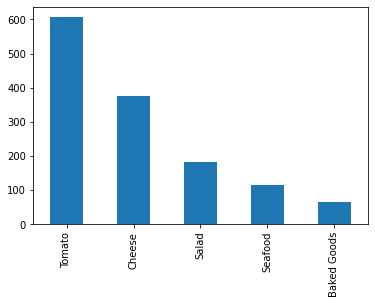

In [ ]:
train_df["class"].value_counts().plot.bar()
train_df["class"].value_counts()

Tomato         96
Cheese         51
Salad          33
Seafood        22
Baked Goods    16
Name: class, dtype: int64

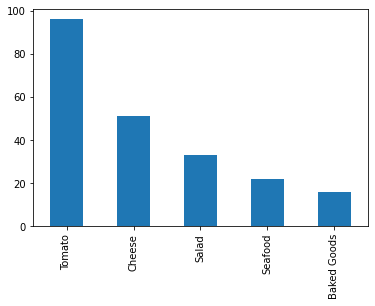

In [ ]:
test_df["class"].value_counts().plot.bar()
test_df["class"].value_counts()

In [ ]:
def show_images(df, is_train=True):
    if is_train:
        root = "/content/train_zip/train"
    else:
        root = "/content/test_zip/test"
    plt.figure(figsize=(15,15))
    for i in range(10):
        n = np.random.choice(df.shape[0], 1)
        plt.subplot(5,5,i+1)
        plt.xticks([])
        plt.yticks([])
        plt.grid(True)
        #image = plt.imread(os.path.join(root, df["filename"][int(n)]))
        #print(df["filename"][int(n)])
        #image = plt.imread(df["filename"][int(n)])
        image = plt.imread(os.path.join(root, df.iloc[int(n),:]["filename"]))
        plt.imshow(image)
        label = df.iloc[int(n),:]["class"]
        plt.xlabel(label)
    plt.show()

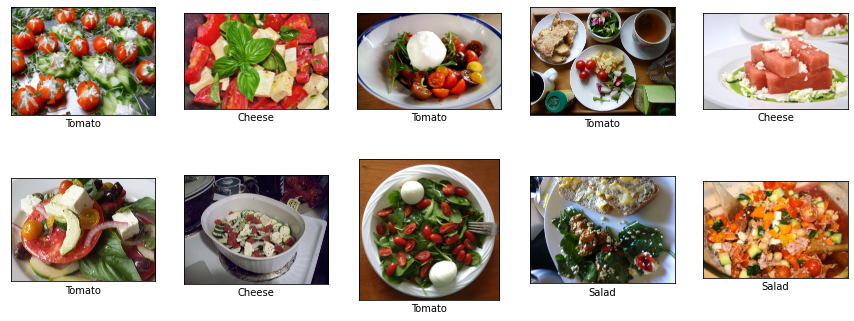

In [ ]:
show_images(train_df)

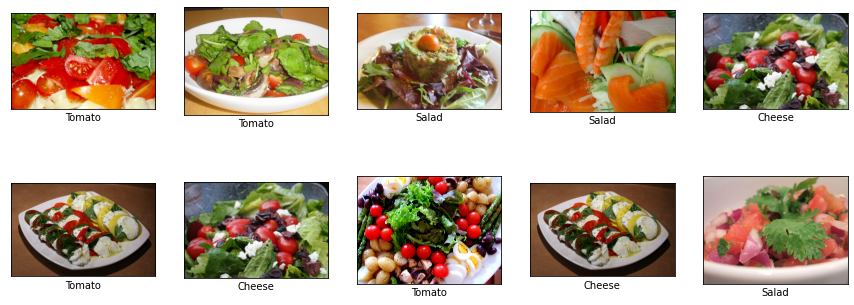

In [ ]:
show_images(test_df, is_train=False)

In [ ]:
def verify_annotations(df, is_train=True):
    if is_train:
        root = "/content/train_zip/train"
    else:
        root = "/content/test_zip/test"
    
    plt.figure(figsize=(12,12))
    for i in range(3):
        n = np.random.choice(df.shape[0], 1)
        plt.subplot(1,3,i+1)
        plt.xticks([])
        plt.yticks([])
        
        #image = plt.imread(os.path.join(root, df["filename"][int(n)]))
        image = plt.imread(os.path.join(root, df.iloc[int(n),:]["filename"]))

        xmin, ymin = int(df.iloc[int(n),:]["xmin"]), int(df.iloc[int(n),:]["ymin"])
        xmax, ymax = int(df.iloc[int(n),:]["xmax"]), int(df.iloc[int(n),:]["ymax"])
        cv2.rectangle(image, (xmin, ymin), (xmax, ymax), (255,0,0), 3)
        plt.imshow(image)
    
    plt.show()

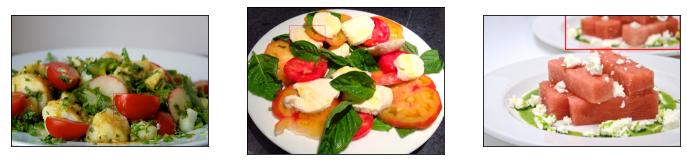

In [ ]:
verify_annotations(train_df, is_train=True)

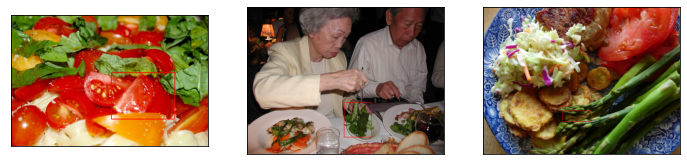

In [ ]:
verify_annotations(test_df, is_train=False)

## Generate TFRecords and `.pbtxt`

The TFRecord format is a simple format for storing a sequence of binary records.
The format is explained [here](https://www.tensorflow.org/tutorials/load_data/tfrecord)
but for our purposes it is enough that the code below created these records for us.

The utility scripts that I used in the following cells were adapted from [this repository](https://github.com/anirbankonar123/CorrosionDetector). 



In [ ]:
%tensorflow_version 2.x
import tensorflow as tf 
print(tf.__version__)

!git clone -q https://github.com/tensorflow/models.git && echo " * Models Directory Cloned"

% cd models/research
!pip install --upgrade pip
# Compile protos.
!protoc object_detection/protos/*.proto --python_out=.
# Install TensorFlow Object Detection API.
!cp object_detection/packages/tf1/setup.py .
!python -m pip install  .

2.4.1
 * Models Directory Cloned
/content/models/research/models/research/models/research/models/research
Processing /content/models/research/models/research/models/research/models/research
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1618434 sha256=7aefc8fa2af2c9212902aa0d027e08ac8551bf4ff3b0bcd164974de08455a6a4
  Stored in directory: /tmp/pip-ephem-wheel-cache-wyd2lsle/wheels/8d/e1/4d/13982c20c28fec952df9ea37f3bae652acbaa2c1654298267f
Successfully built object-detection
  Attempting uninstall: object-detection
    Found existing installation: object-detection 0.1
    Uninstalling object-detection-0.1:
      Successfully uninstalled object-detection-0.1


In [ ]:
!wget -q https://raw.githubusercontent.com/elephantscale/E2E-Object-Detection-in-TFLite/tim/colab_training/generate_tfrecord_tf2.py

--2021-02-08 02:17:02--  https://raw.githubusercontent.com/elephantscale/E2E-Object-Detection-in-TFLite/tim/colab_training/generate_tfrecord_tf2.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4499 (4.4K) [text/plain]
Saving to: ‘generate_tfrecord_tf2.py’

generate_tfrecord_t 100%[===================>]   4.39K  --.-KB/s    in 0s      

2021-02-08 02:17:03 (47.3 MB/s) - ‘generate_tfrecord_tf2.py’ saved [4499/4499]



In [ ]:
!python generate_tfrecord_tf2.py \
    --csv_input=/content/train_zip/train_labels.csv \
    --output_path=/content/train_zip/train.record

2021-02-08 02:17:03.639298: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
Successfully created the TFRecords: /content/train_zip/train.record


In [ ]:
!head /content/test_zip/test_labels.csv 

filename,width,height,class,xmin,ymin,xmax,ymax
3/2851/9211707942_609c7209f8_o.jpg,612,612,Salad,0,0,612,612
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,3,146,104,252
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,18,484,463,611
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,58,349,317,485
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,109,172,266,353
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,199,24,319,151
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,214,189,356,320
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,257,273,453,398
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,349,140,452,288


In [ ]:
!python generate_tfrecord_tf2.py \
    --csv_input=/content/test_zip/test_labels.csv \
    --output_path=/content/test_zip/test.record

2021-02-08 02:17:07.197706: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
Successfully created the TFRecords: /content/test_zip/test.record


In [ ]:
!pwd
!ls -lh /content/test_zip/*.record
!ls -lh /content/train_zip/*.record

/content/models/research/models/research
-rw-r--r-- 1 root root 257M Feb  8 02:17 /content/test_zip/test.record
-rw-r--r-- 1 root root 257M Feb  8 02:17 /content/train_zip/train.record


Be sure to store these `.record` files to somewhere safe. Next, we need to generate a `.pbtxt` file that defines a mapping between our classes and integers. In the `generate_tfrecord.py` script, we used the following mapping - 


In this notebook we will be fine-tuning a **MobileNet** model on the [**salads dataset**](https://storage.googleapis.com/openimages/web/index.html). We will examine the workflow to fine-tune, perform inference, and then export the model to tflite

# Fetch pre-trained Mobilenet model checkpoints and configuration

MobileNet comes in different variants (refer [here](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md)). We will be using the `ssd_mobilenet_v2_320x320_coco17_tpu-8` variant. 

TFOD API operates with configuration files to train and evaluate models (the TF 2 release supports eager model execution too). For the purpose of this notebook, I created a configuration file following instructions from [here](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/configuring_jobs.md). Note that I purposefully kept the `num_steps` argument to 2000. Here's a *non-exhaustive* list of the arguments I changed - 

-  `batch_size: 32`
- `label_map_path` and `input_path` inside `train_input_reader` and `tf_record_input_reader` respectively. The `num_examples` argument inside `eval_config` is set to 117.

### Download model checkpoint and config

In [ ]:
!cd /content/models/research

!wget -q http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
!rm -rf *.config
!wget -q https://raw.githubusercontent.com/elephantscale/E2E-Object-Detection-in-TFLite/tim/colab_training/ssd_mobilenet_v2_320x320_coco17_tpu-8_tf2_4.config


### Untar and verify the file structure of the model checkpoints

In [ ]:
!cd /content/models/research
!tar -xvf ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
!cp /content/test_zip/test.record /content/models/research
!cp /content/train_zip/train.record /content/models/research

ssd_mobilenet_v2_320x320_coco17_tpu-8/
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/checkpoint
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/ckpt-0.index
ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/saved_model.pb
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/variables.data-00000-of-00001
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/variables.index


# Model training

### Start training

We are going to call the python script and run it: "model_main_tf2.py" to 



In [ ]:

import os
os.environ['PYTHONPATH'] += ":/content/models"

import sys
sys.path.append("/content/models")


In [ ]:
!mv /content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint /content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint0



mv: cannot stat '/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint': No such file or directory


In [ ]:

PIPELINE_CONFIG_PATH="/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8_tf2_4.config"


MODEL_DIR="/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8"

!echo $PIPELINE_CONFIG_PATH
!echo $MODEL_DIR

!python object_detection/model_main_tf2.py \
    --pipeline_config_path={PIPELINE_CONFIG_PATH} \
    --model_dir={MODEL_DIR} \
    --alsologtostderr

Streaming output truncated to the last 5000 lines.
array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1.], dtype=float32)>
}, MirroredVariable:{
  0: <tf.Variable 'expanded_conv_depthwise_BN/beta:0' shap

In [ ]:
!ls -d /content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/*


/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint0
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/train


In [ ]:
!zip -r ssd_mobilenet_v2_320x320_coco17_tpu-8.zip ssd_mobilenet_v2_320x320_coco17_tpu-8/

  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/ (stored 0%)
  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config (deflated 67%)
  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/ (stored 0%)
  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/ckpt-0.index (deflated 12%)
  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001 (deflated 7%)
  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/checkpoint (deflated 42%)
  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/ (stored 0%)
  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/ (stored 0%)
  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/variables.index (deflated 14%)
  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/variables.data-00000-of-00001 (deflated 7%)
  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/saved_model.pb (deflated 93%)


# Export TFLite compatible graph

To export the fine-tuned checkpoints to a TFLite model we first need to export a model graph that is compatible with TFLite. More instructions about this are available [here](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/running_on_mobile_tensorflowlite.md). First, we need to determine which checkpoints to be used to export the graph. Let's first take a look at our `MODEL_DIR` to get an idea. 

In [ ]:
!ls -lh $MODEL_DIR

total 20K
drwxr-x--- 2 345018 89939 4.0K Jul 10  2020 checkpoint0
-rw-r----- 1 345018 89939 4.4K Jul 11  2020 pipeline.config
drwxr-x--- 4 345018 89939 4.0K Feb  8 01:00 saved_model
drwxr-xr-x 2 root   root  4.0K Feb  8 02:17 train


In [ ]:
ls -l $MODEL_DIR/saved_model

total 9112
drwxr-xr-x 2 root   root     4096 Feb  8 01:00 assets/
-rw-r--r-- 1 root   root  9321103 Feb  8 01:00 saved_model.pb
drwxr-x--- 2 345018 89939    4096 Feb  8 01:00 variables/


In [ ]:
!find /content -name "*tflite*"

/content/models/research/lstm_object_detection/tflite
/content/models/research/lstm_object_detection/tflite/mobile_ssd_tflite_client.cc
/content/models/research/lstm_object_detection/tflite/mobile_lstd_tflite_client.cc
/content/models/research/lstm_object_detection/tflite/mobile_ssd_tflite_client.h
/content/models/research/lstm_object_detection/tflite/mobile_lstd_tflite_client.h
/content/models/research/lstm_object_detection/export_tflite_lstd_model.py
/content/models/research/lstm_object_detection/export_tflite_lstd_graph_lib.py
/content/models/research/lstm_object_detection/test_tflite_model.py
/content/models/research/lstm_object_detection/export_tflite_lstd_graph.py
/content/models/research/object_detection/export_tflite_graph_tf2.py
/content/models/research/object_detection/export_tflite_graph_lib_tf2.py
/content/models/research/object_detection/export_tflite_ssd_graph.py
/content/models/research/object_detection/export_tflite_ssd_graph_lib_tf1_test.py
/content/models/research/obj

The checkpoint files with the prefix `model.ckpt-2000` are the ones we would be going with. 

In [ ]:
#Export TFLite compatible graph
#Always verify the paths before running this command. 

# OUTPUT:
  # detection_boxes: a float32 tensor of shape [1, num_boxes, 4] with box locations
  # detection_classes: a float32 tensor of shape [1, num_boxes] with class indices
  # detection_scores: a float32 tensor of shape [1, num_boxes] with class scores
  # num_boxes: a float32 tensor of size 1 containing the number of detected boxes

!python /content/models/research/object_detection/export_tflite_graph_tf2.py \
    --pipeline_config_path $PIPELINE_CONFIG_PATH \
    --trained_checkpoint_dir $MODEL_DIR/checkpoint0 \
    --output_directory $MODEL_DIR 


2021-02-08 02:18:53.503399: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2021-02-08 02:18:59.302518: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-02-08 02:18:59.314060: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-02-08 02:18:59.318624: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-02-08 02:18:59.319282: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.73GiB deviceMemoryBandwidth: 298.08GiB/s
2021-02-08 02:18:59.319321: I tensorflow/stream_executor/platform/default/dso_loade

In [ ]:
!ls object_detection/export*

object_detection/exporter_lib_tf2_test.py
object_detection/exporter_lib_v2.py
object_detection/exporter_main_v2.py
object_detection/exporter.py
object_detection/exporter_tf1_test.py
object_detection/export_inference_graph.py
object_detection/export_tflite_graph_lib_tf2.py
object_detection/export_tflite_graph_lib_tf2_test.py
object_detection/export_tflite_graph_tf2.py
object_detection/export_tflite_ssd_graph_lib.py
object_detection/export_tflite_ssd_graph_lib_tf1_test.py
object_detection/export_tflite_ssd_graph.py


### Verify the TFLite compatible graph size

 It should have the `.pb` extension. Be sure to note down the path you would get as the output of code block.

In [ ]:
!ls -lh $MODEL_DIR/saved_model/*.pb

-rw-r--r-- 1 root root 8.9M Feb  8 02:19 /content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/saved_model.pb


Now that we have the graph wcan convert it to TensorFlow Lite.

# Optionally see the model losses in TensorBoard (within Colab Notebook)

Note If you trained for 2000 steps only you are likely to see poor numbers in TensorBoard. But as I had mentioned training a SoTA model is not the purpose of this notebook. 

In [ ]:

%tensorflow_version 2.x
%load_ext tensorboard
%tensorboard --logdir /content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

# Export to TFLite

### Quantize and serialize

For the purpose of this notebook, we will only be quantizing using the [dynamic-range quantization](https://www.tensorflow.org/lite/performance/post_training_quant). But you can follow [this notebook](https://colab.research.google.com/github/sayakpaul/Adventures-in-TensorFlow-Lite/blob/master/MobileDet_Conversion_TFLite.ipynb) if you are interested to try out the other ones like integer quantization and `float16` quantization. 

As the .pb file we generated in the earlier step is a frozen graph, we need to use `tf.compat.v1.lite.TFLiteConverter.from_frozen_graph` to convert it to TFLite.

The MobileNet checkpoints we used accept 320x320 images, hence the `input_shapes` argument is specified that way. I specified the other arguments following instructions from [here](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/running_on_mobile_tensorflowlite.md).


In [ ]:
saved_model_dir = "/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model"

converter = tf.lite.TFLiteConverter.from_saved_model(saved_model_dir)
converter.target_spec.supported_ops = [
  tf.lite.OpsSet.TFLITE_BUILTINS, # enable TensorFlow Lite ops.
  tf.lite.OpsSet.SELECT_TF_OPS # enable TensorFlow ops.
]
tflite_filename = "salads_detector" + "_dr" + ".tflite"
tflite_model = converter.convert()
open(tflite_filename, "wb").write(tflite_model)
print(f"TFLite model generated: {tflite_filename}")
!ls -lh $tflite_filename
!pwd
!cp $tflite_filename /content

TFLite model generated: salads_detector_dr.tflite
-rw-r--r-- 1 root root 24M Feb  8 02:19 salads_detector_dr.tflite
/content/models/research/models/research


# Run inference

In [ ]:
#Imports
import matplotlib
import matplotlib.pyplot as plt

import cv2
import re
import time
import numpy as np

from PIL import Image

### TFLite Interpreter and detection utils 

Sourced from [here](https://github.com/tensorflow/examples/blob/master/lite/examples/object_detection/raspberry_pi/detect_picamera.py).


In [ ]:

def set_input_tensor(interpreter, image):
  """Sets the input tensor."""
  tensor_index = interpreter.get_input_details()[0]['index']
  input_tensor = interpreter.tensor(tensor_index)()[0]
  input_tensor[:, :] = image


def get_output_tensor(interpreter, index):
  """Returns the output tensor at the given index."""
  output_details = interpreter.get_output_details()[index]
  tensor = np.squeeze(interpreter.get_tensor(output_details['index']))
  return tensor


def detect_objects(interpreter, image, threshold):
  """Returns a list of detection results, each a dictionary of object info."""
  set_input_tensor(interpreter, image)
  interpreter.invoke()

  # Get all output details
  boxes = get_output_tensor(interpreter, 0)
  classes = get_output_tensor(interpreter, 1)
  scores = get_output_tensor(interpreter, 2)
  count = int(get_output_tensor(interpreter, 3))

  results = []
  for i in range(count):
    if scores[i] >= threshold:
      result = {
          'bounding_box': boxes[i],
          'class_id': classes[i],
          'score': scores[i]
      }

      print('result: ', result)

      results.append(result)
  return results

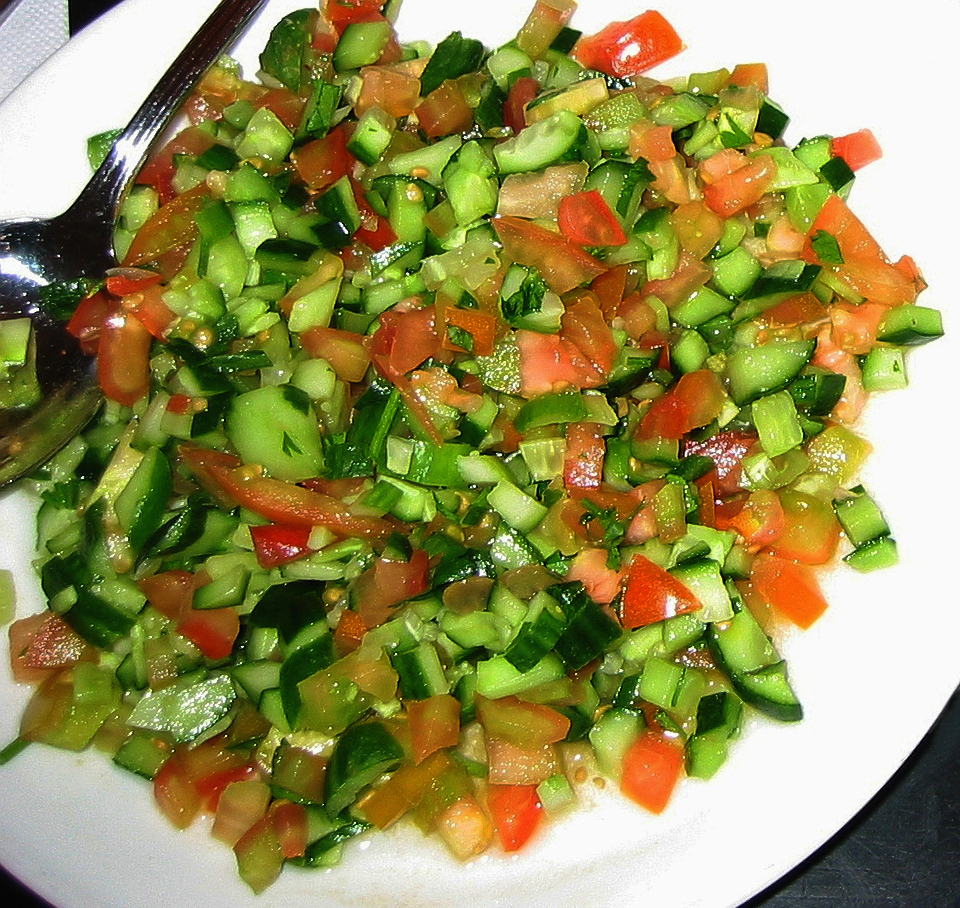

In [ ]:
# Supply a path to download a relevant image
IMAGE_PATH = "https://upload.wikimedia.org/wikipedia/commons/0/04/Salad.jpg" 

!wget -q -O image.png $IMAGE_PATH
!cp image.png /content
Image.open('image.png')

In [ ]:
# Load the TFLite model
interpreter = tf.lite.Interpreter(model_path="/content/salads_detector_dr.tflite")
interpreter.allocate_tensors()
_, HEIGHT, WIDTH, _ = interpreter.get_input_details()[0]['shape']
print(f"Height and width accepted by the model: {HEIGHT, WIDTH}")

Height and width accepted by the model: (300, 300)


In [ ]:
# Image preprocessing utils
def preprocess_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.io.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)
    original_image = img
    resized_img = tf.image.resize(img, (HEIGHT, WIDTH))
    resized_img = resized_img[tf.newaxis, :]
    return resized_img, original_image

In [ ]:
# Define the label dictionary and color map

COLORS = np.random.randint(0, 255, size=(len(LABEL_DICT), 3), 
                            dtype="uint8")

In [ ]:
# Inference utils
def display_results(image_path, threshold=0.3):
    # Load the input image and preprocess it
    preprocessed_image, original_image = preprocess_image(image_path)

    # =============Perform inference=====================
    start_time = time.monotonic()
    results = detect_objects(interpreter, preprocessed_image, threshold=threshold)
    print(f"Elapsed time: {(time.monotonic() - start_time)*1000} miliseconds")

    # =============Display the results====================
    original_numpy = original_image.numpy()
    for obj in results:
        # Convert the bounding box figures from relative coordinates
        # to absolute coordinates based on the original resolution
        ymin, xmin, ymax, xmax = obj['bounding_box']
        xmin = int(xmin * original_numpy.shape[1])
        xmax = int(xmax * original_numpy.shape[1])
        ymin = int(ymin * original_numpy.shape[0])
        ymax = int(ymax * original_numpy.shape[0])

        # Grab the class index for the current iteration
        idx = int(obj['class_id'])
        # Skip the background
        if idx >= len(LABEL_DICT):
            continue

        # Draw the bounding box and label on the image
        color = [int(c) for c in COLORS[idx]]
        cv2.rectangle(original_numpy, (xmin, ymin), (xmax, ymax), 
                    color, 2)
        y = ymin - 15 if ymin - 15 > 15 else ymin + 15
        # label = "{}: {:.2f}%".format(REVERSE_LABEL_DICT[idx], obj['score'] * 100) TODO: FIX THIS
        label= ""
        cv2.putText(original_numpy, label, (xmin, y),
            cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # return the final imaage
    original_int = (original_numpy * 255).astype(np.uint8)
    return original_int

result:  {'bounding_box': array([0.01643589, 0.01548445, 0.9809127 , 0.9751218 ], dtype=float32), 'class_id': 56.0, 'score': 0.5453815}
result:  {'bounding_box': array([0.21305706, 0.5722497 , 0.27983603, 0.6435098 ], dtype=float32), 'class_id': 56.0, 'score': 0.5190803}
result:  {'bounding_box': array([0.6000446 , 0.78844094, 0.69705546, 0.8683368 ], dtype=float32), 'class_id': 56.0, 'score': 0.5017094}
result:  {'bounding_box': array([0.32753256, 0.08630294, 0.43986455, 0.15841562], dtype=float32), 'class_id': 56.0, 'score': 0.49912763}
result:  {'bounding_box': array([0.62504214, 0.62550205, 0.690582  , 0.73182994], dtype=float32), 'class_id': 56.0, 'score': 0.47598773}
result:  {'bounding_box': array([0.8030387 , 0.63590574, 0.90017235, 0.70835483], dtype=float32), 'class_id': 56.0, 'score': 0.4554466}
result:  {'bounding_box': array([0.41057688, 0.6506407 , 0.5036123 , 0.756613  ], dtype=float32), 'class_id': 56.0, 'score': 0.4314906}
result:  {'bounding_box': array([0.00324008, 0

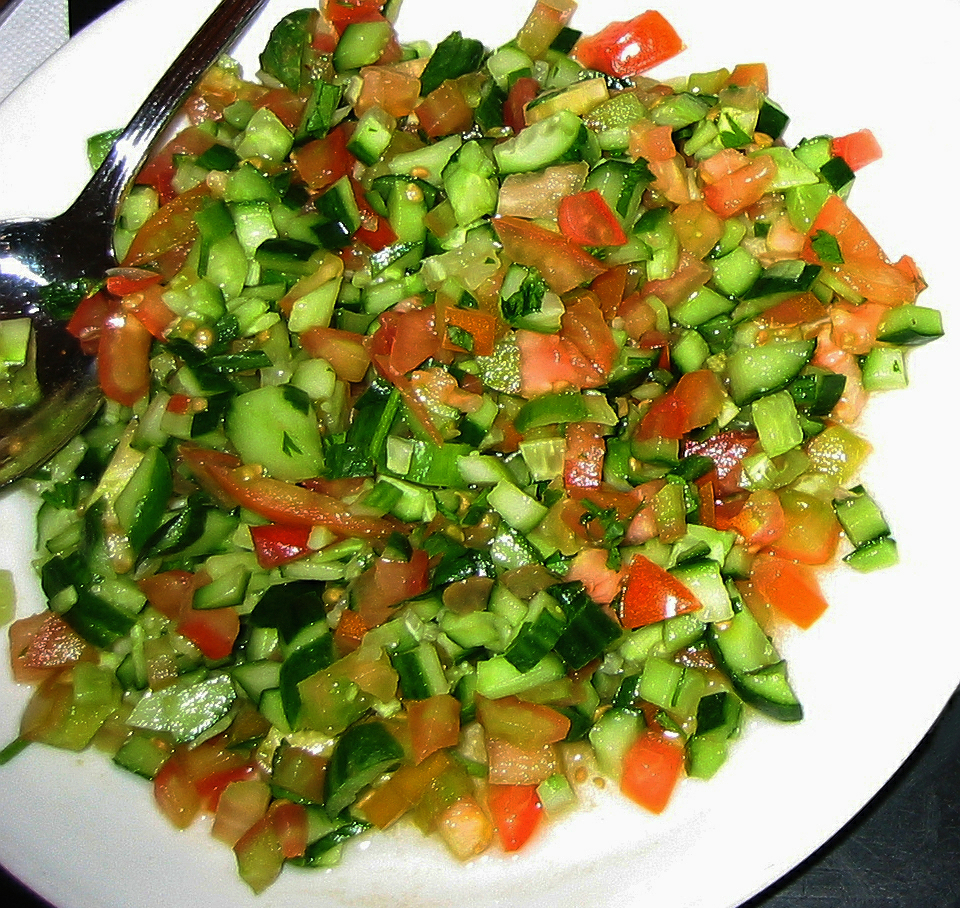

In [ ]:
# Run inference and measure the inference time
resultant_image = display_results("/content/image.png", threshold=0.3)
Image.fromarray(resultant_image)

In [ ]:
# Define the label dictionary and color map


COLORS = np.random.randint(0, 255, size=(len(LABEL_DICT), 3), 
                            dtype="uint8")

In [ ]:

# Inference utils
def display_results(image_path, threshold=0.3):
    # Load the input image and preprocess it
    preprocessed_image, original_image = preprocess_image(image_path)

    # =============Perform inference=====================
    start_time = time.monotonic()
    results = detect_objects(interpreter, preprocessed_image, threshold=threshold)
    print(f"Elapsed time: {(time.monotonic() - start_time)*1000} miliseconds")

    # =============Display the results====================
    original_numpy = original_image.numpy()
    for obj in results:
        # Convert the bounding box figures from relative coordinates
        # to absolute coordinates based on the original resolution
        ymin, xmin, ymax, xmax = obj['bounding_box']
        xmin = int(xmin * original_numpy.shape[1])
        xmax = int(xmax * original_numpy.shape[1])
        ymin = int(ymin * original_numpy.shape[0])
        ymax = int(ymax * original_numpy.shape[0])

        print('box: ', xmin, ymin, ' - ', xmax, ymax)

        # Grab the class index for the current iteration
        idx = int(obj['class_id'])
        # Skip the background
        if idx >= len(LABEL_DICT):
          print(str(idx) + ' idx >= len(LABEL_DICT)')
          pass
          # continue

        # Draw the bounding box and label on the image
        #color = [int(c) for c in COLORS[idx]]
        color = [int(c) for c in COLORS[0]]
        cv2.rectangle(original_numpy, (xmin, ymin), (xmax, ymax), 
                    color, 2)
        y = ymin - 15 if ymin - 15 > 15 else ymin + 15
        reverse_label = REVERSE_LABEL_DICT[idx] if idx in REVERSE_LABEL_DICT else 'Other'
        if idx == 56:
          reverse_label = 'Tomato'
        label = "{}: {:.2f}%".format(reverse_label, obj['score'] * 100) #TODO: Fix THis
        #label= ""
        cv2.putText(original_numpy, label, (xmin, y),
            cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # return the final imaage
    original_int = (original_numpy * 255).astype(np.uint8)
    return original_int

result:  {'bounding_box': array([0.01643589, 0.01548445, 0.9809127 , 0.9751218 ], dtype=float32), 'class_id': 56.0, 'score': 0.5453815}
result:  {'bounding_box': array([0.21305706, 0.5722497 , 0.27983603, 0.6435098 ], dtype=float32), 'class_id': 56.0, 'score': 0.5190803}
result:  {'bounding_box': array([0.6000446 , 0.78844094, 0.69705546, 0.8683368 ], dtype=float32), 'class_id': 56.0, 'score': 0.5017094}
result:  {'bounding_box': array([0.32753256, 0.08630294, 0.43986455, 0.15841562], dtype=float32), 'class_id': 56.0, 'score': 0.49912763}
result:  {'bounding_box': array([0.62504214, 0.62550205, 0.690582  , 0.73182994], dtype=float32), 'class_id': 56.0, 'score': 0.47598773}
result:  {'bounding_box': array([0.8030387 , 0.63590574, 0.90017235, 0.70835483], dtype=float32), 'class_id': 56.0, 'score': 0.4554466}
result:  {'bounding_box': array([0.41057688, 0.6506407 , 0.5036123 , 0.756613  ], dtype=float32), 'class_id': 56.0, 'score': 0.4314906}
result:  {'bounding_box': array([0.00324008, 0

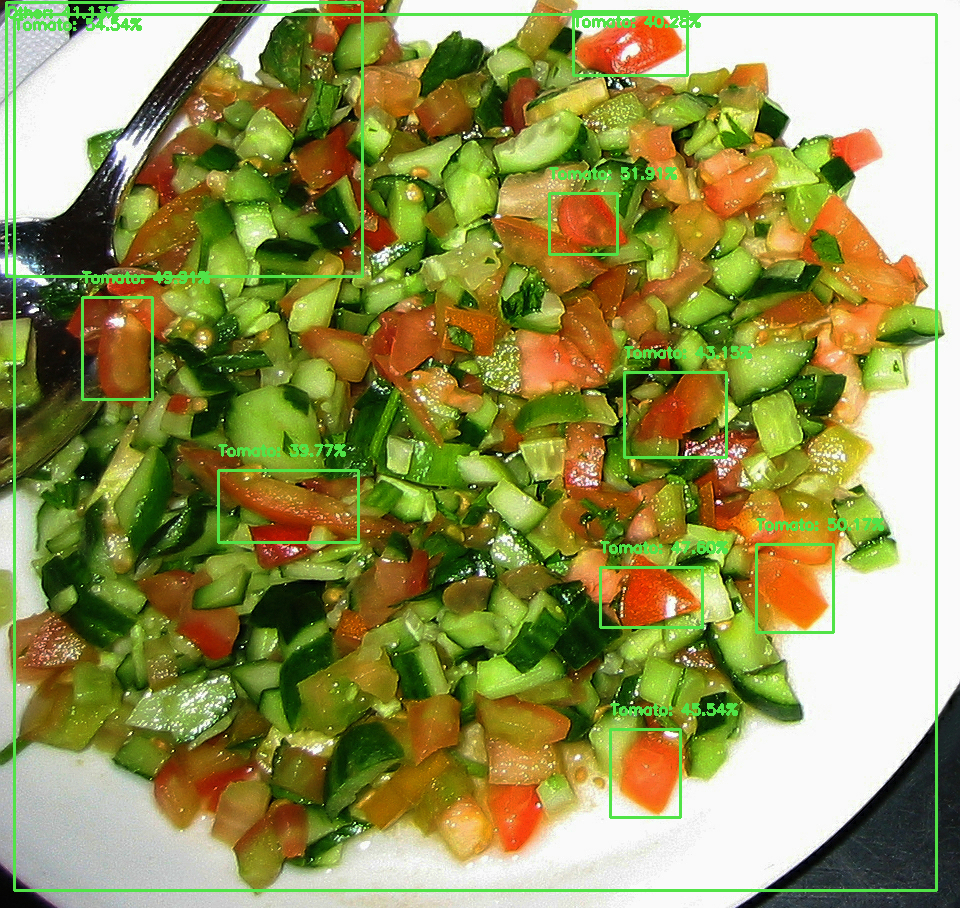

In [ ]:
# Run inference and measure the inference time
resultant_image = display_results("/content/image.png", threshold=0.3)
Image.fromarray(resultant_image)

**Note** that you might see some unexpected results because the annotations in the training dataset are faulty at places. Due to this the model training can suffer a lot. 